In [126]:
import pandas as pd
import geopandas as gpd
import salem
import matplotlib.pyplot as plt
import os
import cv2
from PIL import Image
import numpy as np

In [39]:
village_gdf = gpd.read_file(r"C:\Users\kittisak\Desktop\KBTG\find_village\village_position\village.shp")
village_gdf

,LU_ID_L1,LU_ID_L2,LU_ID_L3,LU_CODE,LU_DES_TH,LU_DES_EN,LUL1_CODE,LUL2_CODE,LU_DES,Shape_Area,RAI,LUL1_DES,LUL2_DES,geometry
0,1.0,12.0,1201.0,U201,?????????????????,Village,U,U2,????????,6295.423302,4.0,????????????????????????????,????????,"POLYGON ((98.33480 18.35543, 98.33476 18.35528..."
1,1.0,12.0,1201.0,U201,?????????????????,Village,U,U2,????????,7378.902808,5.0,????????????????????????????,????????,"POLYGON ((98.33569 18.35622, 98.33562 18.35621..."
2,1.0,12.0,1201.0,U201,?????????????????,Village,U,U2,????????,71094.925375,44.0,????????????????????????????,????????,"POLYGON ((98.57005 18.82221, 98.57006 18.82215..."
3,1.0,12.0,1201.0,U201,?????????????????,Village,U,U2,??????????????,43430.188497,27.0,????????????????????????????,????????,"POLYGON ((99.00699 18.73684, 99.00699 18.73679..."
4,1.0,12.0,1201.0,U201,?????????????????,Village,U,U2,??????????????????,19397.329298,12.0,????????????????????????????,????????,"POLYGON ((98.97922 19.23034, 98.97912 19.23027..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,1.0,12.0,1201.0,U201,?????????????????,Village,U,U2,??????????????,114683.304453,72.0,????????????????????????????,????????,"POLYGON ((100.32612 13.97087, 100.32552 13.969..."
117,1.0,12.0,1201.0,U201,?????????????????,Village,U,U2,??????????????,152899.017049,96.0,????????????????????????????,????????,"POLYGON ((100.32634 13.98014, 100.32410 13.976..."
118,1.0,12.0,1201.0,U201,?????????????????,Village,U,U2,??????????????,141592.644397,88.0,????????????????????????????,????????,"POLYGON ((100.34178 13.97997, 100.33969 13.977..."
119,1.0,12.0,1201.0,U201,?????????????????,Village,U,U2,??????????????,495793.240537,310.0,????????????????????????????,????????,"POLYGON ((100.32204 13.98881, 100.32360 13.988..."


In [71]:
village_gdf.iloc[:].explore(tiles='http://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}',attr='Google')

In [70]:
village_gdf.iloc[9:10].explore(tiles='http://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}',attr='Google')

Text(0.5, 1.0, 'Google static map')

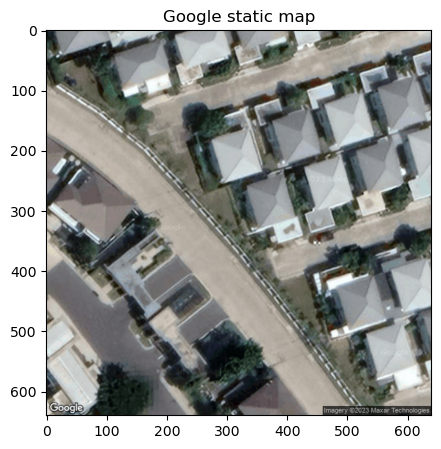

In [98]:
import salem
from salem import GoogleVisibleMap

#13.977802707331845, 100.50446400609304 อาณาสิริ
# Define the bounding box 

min_lon, min_lat = 100.50446400609304 ,13.977802707331845
max_lon, max_lat = min_lon+0.0002 , min_lat + 0.0002

    
# Download the satellite imagery using the GoogleVisibleMap 
google_map = GoogleVisibleMap(x=[min_lon, max_lon], y=[min_lat, max_lat], maptype='satellite')
# Create a salem image data
img = google_map.get_vardata()
f, ax1 = plt.subplots(figsize=(12, 5))
# Save the downloaded image data as a GeoTIFF file
ax1.imshow(img)
ax1.set_title('Google static map')

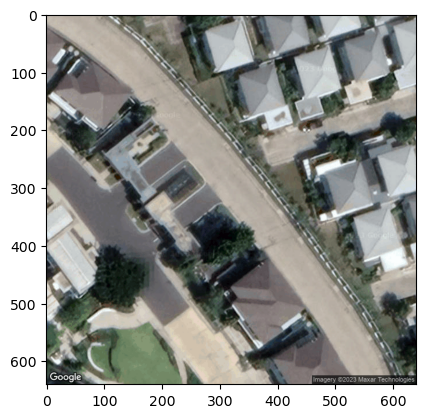

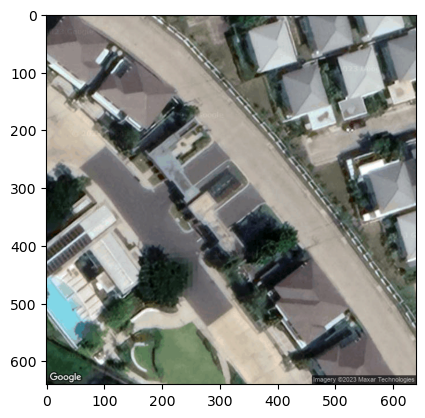

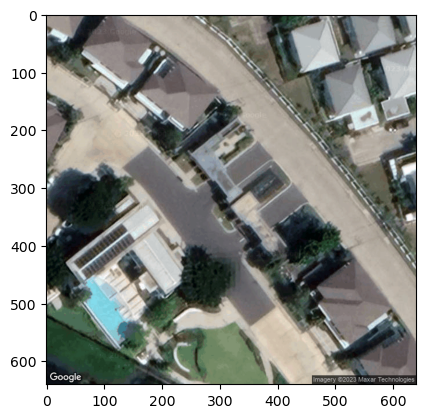

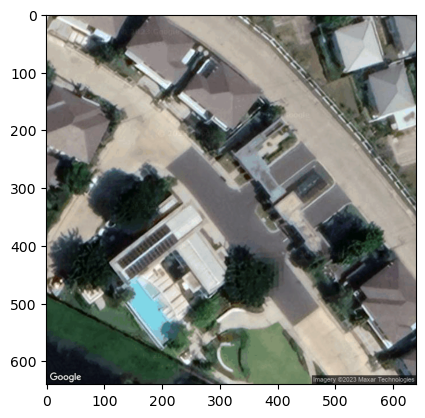

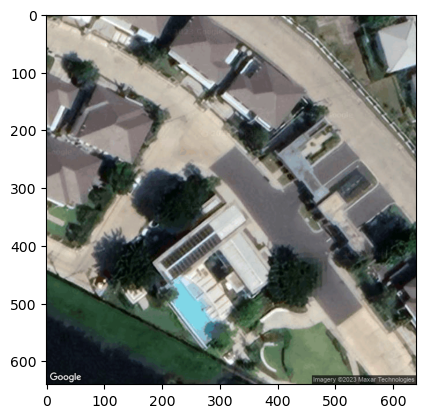

...

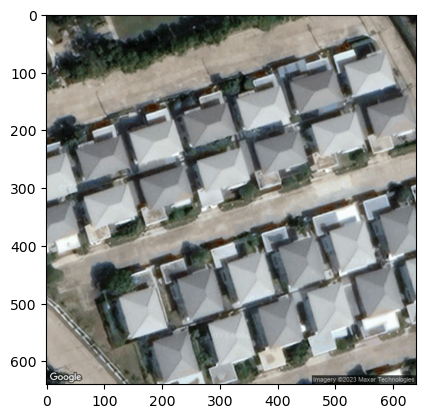

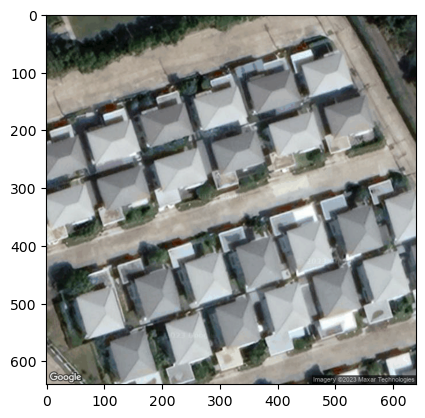

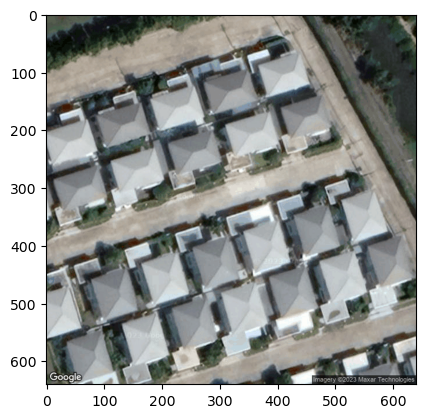

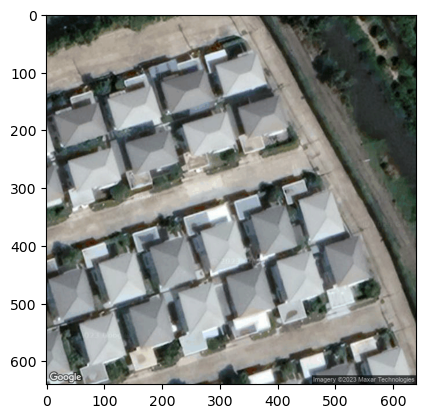

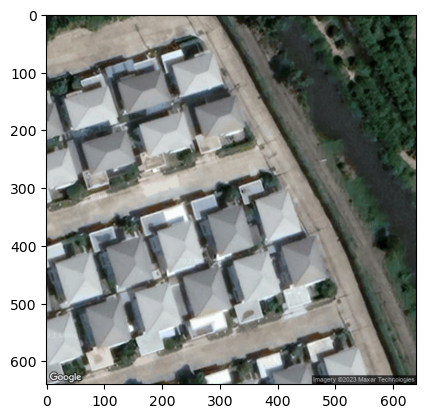

In [135]:
import salem
from salem import GoogleVisibleMap

#13.977802707331845, 100.50446400609304 อาณาสิริ
# Define the bounding box 

min_lon, min_lat = 100.50446400609304 ,13.977802707331845
lat_direction_list = [-1,1]
long_direction_list = [-1,1]
step = 0.0001
pic_num = 1
for lat_direction in lat_direction_list:
    for i in range(5):
        add_lat = step*(i+1)*lat_direction
        for long in long_direction_list:
            for j in range(5):
                add_long = step*(j+1)*long
                
                pic_lat = min_lat + add_lat
                pic_long = max_lon + add_long
                # Download the satellite imagery using the GoogleVisibleMap 
                google_map = GoogleVisibleMap(x=[pic_long-0.0001, pic_long+0.0001], y=[pic_lat-0.0001, pic_lat + 0.0001], maptype='satellite')
                # Create a salem image data
                img = google_map.get_vardata()
                

                # Save the downloaded image data as a GeoTIFF file
                plt.imshow(img)
                plt.show()
                directory = r"C:\Users\kittisak\Desktop\KBTG\find_village\image"
                name = 'อณาสิริ'+'_'+str(pic_num)+'.png'
                img_dir = os.path.join(directory,name)
                
                im = Image.fromarray((img * 255).astype(np.uint8))
                im.save(img_dir)
                pic_num += 1 


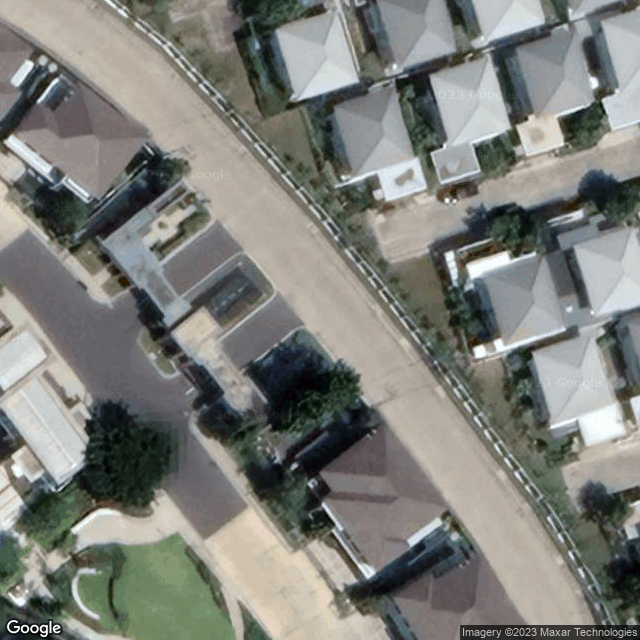

In [132]:
Image.fromarray((img * 255).astype(np.uint8))